Restaurant Revenue Prediction

###1.Importing Libraries and Datasets

In [259]:

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from vecstack import stacking

from datetime import date
from datetime import datetime

from sklearn.preprocessing import StandardScaler, MinMaxScaler, OrdinalEncoder, OneHotEncoder
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import SGDRegressor, Ridge, Lasso
from sklearn.decomposition import PCA
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from sklearn.model_selection import GridSearchCV
from IPython.display import Image
from sklearn.metrics import make_scorer
from sklearn.datasets import make_regression
from sklearn.neural_network import MLPRegressor
from sklearn.linear_model import SGDRegressor
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler


from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

sns.set_style(style=("darkgrid"))
plt.figure(figsize=(5, 5))

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

In [260]:
!pip install vecstack

In [261]:
import os
os.chdir(r"C:\Users\drako\Downloads\restaurant-revenue-prediction")
train = pd.read_csv("train.csv")
test = pd.read_csv("test.csv")
sample_sub = pd.read_csv("sampleSubmission.csv")

In [262]:
id =test['Id']

In [263]:
train.head()

,Id,Open Date,City,City Group,Type,P1,P2,P3,P4,P5,...,P29,P30,P31,P32,P33,P34,P35,P36,P37,revenue
0,0,07/17/1999,İstanbul,Big Cities,IL,4,5.0,4.0,4.0,2,...,3.0,5,3,4,5,5,4,3,4,5653753.0
1,1,02/14/2008,Ankara,Big Cities,FC,4,5.0,4.0,4.0,1,...,3.0,0,0,0,0,0,0,0,0,6923131.0
2,2,03/09/2013,Diyarbakır,Other,IL,2,4.0,2.0,5.0,2,...,3.0,0,0,0,0,0,0,0,0,2055379.0
3,3,02/02/2012,Tokat,Other,IL,6,4.5,6.0,6.0,4,...,7.5,25,12,10,6,18,12,12,6,2675511.0
4,4,05/09/2009,Gaziantep,Other,IL,3,4.0,3.0,4.0,2,...,3.0,5,1,3,2,3,4,3,3,4316715.0


In [264]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 137 entries, 0 to 136
Data columns (total 43 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Id          137 non-null    int64  
 1   Open Date   137 non-null    object 
 2   City        137 non-null    object 
 3   City Group  137 non-null    object 
 4   Type        137 non-null    object 
 5   P1          137 non-null    int64  
 6   P2          137 non-null    float64
 7   P3          137 non-null    float64
 8   P4          137 non-null    float64
 9   P5          137 non-null    int64  
 10  P6          137 non-null    int64  
 11  P7          137 non-null    int64  
 12  P8          137 non-null    int64  
 13  P9          137 non-null    int64  
 14  P10         137 non-null    int64  
 15  P11         137 non-null    int64  
 16  P12         137 non-null    int64  
 17  P13         137 non-null    float64
 18  P14         137 non-null    int64  
 19  P15         137 non-null    i

###2.EDA and Feature Selction

In [265]:
train['year'] = pd.DatetimeIndex(train['Open Date']).year
train['month'] = pd.DatetimeIndex(train['Open Date']).month

In [266]:
fig = px.histogram(train, x="City", y="revenue",
            color='City Group', template='plotly_dark', histfunc='avg')
fig.show()

In [267]:
fig2 = px.histogram(train, x="City Group", y="revenue",
            template='plotly_dark', histfunc='avg')
fig2.show()

In [268]:
fig3 = px.histogram(train, x="Type", y="revenue",
            template='plotly_dark', histfunc='avg')
fig3.show()

As it is observed form the graphs:
  - Restraunts located in big cities have more revenue
  - Food Court style restraunts generate more average revenue from all the types



In [269]:
#dropping ID and date column since date has been converted to month and year
train.drop(['Id','Open Date'], axis=1, inplace=True)

In [270]:
train.describe()

,P1,P2,P3,P4,P5,P6,P7,P8,P9,P10,...,P31,P32,P33,P34,P35,P36,P37,revenue,year,month
count,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,...,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,1.370000e+02,137.000000,137.000000
mean,4.014599,4.408759,4.317518,4.372263,2.007299,3.357664,5.423358,5.153285,5.445255,5.489051,...,1.941606,2.525547,1.138686,2.489051,2.029197,2.211679,1.116788,4.453533e+06,2008.678832,7.058394
std,2.910391,1.514900,1.032337,1.016462,1.209620,2.134235,2.296809,1.858567,1.834793,1.847561,...,3.512093,5.230117,1.698540,5.165093,3.436272,4.168211,1.790768,2.576072e+06,4.027359,3.590769
min,1.000000,1.000000,0.000000,3.000000,1.000000,1.000000,1.000000,1.000000,4.000000,4.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.149870e+06,1996.000000,1.000000
25%,2.000000,4.000000,4.000000,4.000000,1.000000,2.000000,5.000000,4.000000,4.000000,5.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.999068e+06,2007.000000,4.000000
50%,3.000000,5.000000,4.000000,4.000000,2.000000,3.000000,5.000000,5.000000,5.000000,5.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.939804e+06,2010.000000,8.000000
75%,4.000000,5.000000,5.000000,5.000000,2.000000,4.000000,5.000000,5.000000,5.000000,5.000000,...,3.000000,3.000000,2.000000,3.000000,4.000000,3.000000,2.000000,5.166635e+06,2011.000000,10.000000
max,12.000000,7.500000,7.500000,7.500000,8.000000,10.000000,10.000000,10.000000,10.000000,10.000000,...,15.000000,25.000000,6.000000,24.000000,15.000000,20.000000,8.000000,1.969694e+07,2014.000000,12.000000


In [271]:
fig5 = make_subplots(rows=3, cols=2)

fig5.add_trace(
    go.Histogram(x=train['P14']),
    row=1, col=1
)

fig5.add_trace(
    go.Histogram(x=train['P15']),
    row=1, col=2
)

fig5.add_trace(
    go.Histogram(x=train['P16']),
    row=2, col=1
)

fig5.add_trace(
    go.Histogram(x=train['P17']),
    row=2, col=2
)

fig5.add_trace(
    go.Histogram(x=train['P18']),
    row=3, col=1
)


fig5.update_layout(height=800, width=1200, template='plotly_dark', title_text="Side By Side Subplots")
fig5.show()


<AxesSubplot:>

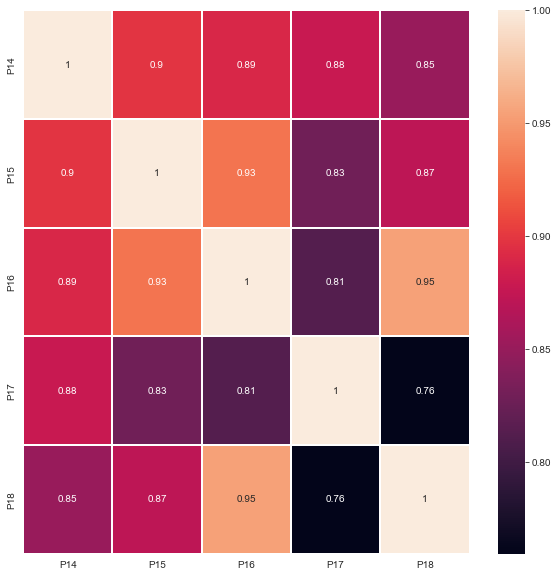

In [272]:
fig6, ax = plt.subplots(figsize=(10,10)) 
correlation_matrix = train[['P14','P15','P16','P17','P18']].corr()
sns.heatmap(correlation_matrix,annot=True,linewidths=.3,ax=ax)

- As we see from the histograms and the confusion matrix P14-P18 are highly correlated and have a similar histogram distribution so we can keep one of them and drop the rest

In [273]:
train.drop(['P14','P16','P17','P18'], axis=1, inplace=True)

In [274]:
cat_columns = ['City','City Group','Type','month','year']

In [275]:
#one hot encoding for all the catagorical data
for col in  cat_columns:
    train = pd.concat([train.drop(col, axis=1),pd.get_dummies(train[col], prefix=col, prefix_sep='_',drop_first=True, dummy_na=False)], axis=1)

In [276]:
train.head()

,P1,P2,P3,P4,P5,P6,P7,P8,P9,P10,...,year_2005,year_2006,year_2007,year_2008,year_2009,year_2010,year_2011,year_2012,year_2013,year_2014
0,4,5.0,4.0,4.0,2,2,5,4,5,5,...,0,0,0,0,0,0,0,0,0,0
1,4,5.0,4.0,4.0,1,2,5,5,5,5,...,0,0,0,1,0,0,0,0,0,0
2,2,4.0,2.0,5.0,2,3,5,5,5,5,...,0,0,0,0,0,0,0,0,1,0
3,6,4.5,6.0,6.0,4,4,10,8,10,10,...,0,0,0,0,0,0,0,1,0,0
4,3,4.0,3.0,4.0,2,2,5,5,5,5,...,0,0,0,0,1,0,0,0,0,0


In [277]:
X_train=train.drop('revenue', axis=1)
y_train=train['revenue']

##Preparing the test data

In [278]:
test['year'] = pd.DatetimeIndex(test['Open Date']).year
test['month'] = pd.DatetimeIndex(test['Open Date']).month
test.drop(['Id','Open Date'], axis=1, inplace=True)
test.drop(['P14','P16','P17','P18'], axis=1, inplace=True)
for col in  cat_columns:
    test = pd.concat([test.drop(col, axis=1),pd.get_dummies(test[col], prefix=col, prefix_sep='_',drop_first=True, dummy_na=False)], axis=1)

In [279]:
X_train.shape

(137, 96)

In [280]:
not_in=[]
for i in test.columns:
  if i not in X_train.columns:
    not_in.append(i)
test.drop(not_in, axis=1, inplace=True)

In [281]:
test.shape

(100000, 90)

In [282]:
not_in=[]
for i in X_train.columns:
  if i not in test.columns:
    not_in.append(i)
X_train.drop(not_in, axis=1, inplace=True)


###Model Building

##RandomForestRegressor

In [283]:
mse = make_scorer(mean_squared_error,greater_is_better=False)

In [284]:
rf = RandomForestRegressor()
params = [{'n_estimators': [100,500,1000],
         'max_features': [2, 3, 4]}]
gs_rf = GridSearchCV(rf,
                      param_grid=params,scoring=mse,
                      cv=3)
gs_rf.fit(X_train, y_train)
gs_rf.best_params_


{'max_features': 3, 'n_estimators': 1000}

In [285]:
rf = RandomForestRegressor(n_estimators=1000, max_features=4)
rf.fit(X_train, y_train)

RandomForestRegressor(max_features=4, n_estimators=1000)

In [286]:
pred=rf.predict(test)

In [287]:
submission_res = pd.DataFrame({'Id':id, 'Prediction':pred})
submission_res

,Id,Prediction
0,0,4264787.523
1,1,3661554.579
2,2,3987300.306
3,3,3604148.774
4,4,4327794.297
...,...,...
99995,99995,5171836.020
99996,99996,3184768.150
99997,99997,4940828.167
99998,99998,4972302.359


In [288]:
submission_res.to_csv('submission_res.csv', index=False)

#DecisionTree Regressor

In [289]:
dt = DecisionTreeRegressor()
params = [{ "max_depth": ["None",10, 40, 80],
            "max_features": ["auto","sqrt","log2"],
            "min_samples_leaf": [1,3,5,7],
            "min_samples_split": [2, 6, 12],
            "random_state" : [42],
            "splitter" : ["best","random"]}]
dt_grid = GridSearchCV(dt,
                      param_grid=params,scoring=mse,
                      cv=3)
dt_grid.fit(X_train, y_train)
dt_grid.best_params_


C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: Fut

{'max_depth': 10,
 'max_features': 'auto',
 'min_samples_leaf': 5,
 'min_samples_split': 12,
 'random_state': 42,
 'splitter': 'random'}

In [290]:
dt = DecisionTreeRegressor(max_depth=10, max_features='log2', min_samples_leaf= 3, 
                           min_samples_split= 12, random_state=42, splitter='random')
dt.fit(X_train, y_train)

DecisionTreeRegressor(max_depth=10, max_features='log2', min_samples_leaf=3,
                      min_samples_split=12, random_state=42, splitter='random')

In [291]:
pred_dt=dt.predict(test)

In [292]:
submission_dt= pd.DataFrame({'Id':id, 'Prediction':pred_dt})
submission_dt

,Id,Prediction
0,0,3.765846e+06
1,1,3.332058e+06
2,2,3.765846e+06
3,3,3.332058e+06
4,4,3.765846e+06
...,...,...
99995,99995,3.765846e+06
99996,99996,4.909967e+06
99997,99997,4.756568e+06
99998,99998,5.797462e+06


In [293]:
submission_dt.to_csv('submission_dt.csv', index=False)

#KNeighborsRegressor

In [294]:
knn = KNeighborsRegressor()
params = [{'n_neighbors': [3,5,7,9,11],
          'leaf_size':range(1,50,5),
          'p':[1,2,]}]
knn_grid = GridSearchCV(knn,
                      param_grid=params,scoring=mse,
                      cv=3)
knn_grid.fit(X_train, y_train)
knn_grid.best_params_


{'leaf_size': 1, 'n_neighbors': 9, 'p': 1}

In [295]:
knn = KNeighborsRegressor(leaf_size=1, n_neighbors=5, p=1)
knn.fit(X_train, y_train)

KNeighborsRegressor(leaf_size=1, p=1)

In [296]:
pred_knn=knn.predict(test)

In [297]:
submission_knn= pd.DataFrame({'Id':id, 'Prediction':pred_knn})
submission_knn

,Id,Prediction
0,0,4138915.2
1,1,3067550.8
2,2,4798439.4
3,3,3106478.6
4,4,8463123.2
...,...,...
99995,99995,4149323.2
99996,99996,3131909.6
99997,99997,4600871.8
99998,99998,5063153.0


In [298]:
submission_knn.to_csv('submission_knn.csv', index=False)

#SVR

In [299]:
svm = SVR()
param = {'kernel' : ('linear', 'poly', 'rbf', 'sigmoid'),'C' : [1,5,10],'degree' : [3,8]}

svm_grid = GridSearchCV(svm,param, scoring=mse, cv=3)

svm_grid.fit(X_train,y_train)
svm_grid.best_params_

{'C': 5, 'degree': 8, 'kernel': 'poly'}

In [300]:
svm=SVR(C=5, degree=8, kernel='poly')
svm.fit(X_train, y_train)

SVR(C=5, degree=8, kernel='poly')

In [301]:
pred_svm=svm.predict(test)

In [302]:
submission_svm= pd.DataFrame({'Id':id, 'Prediction':pred_svm})
submission_svm

,Id,Prediction
0,0,3.903878e+06
1,1,3.903850e+06
2,2,3.903927e+06
3,3,3.903847e+06
4,4,3.903837e+06
...,...,...
99995,99995,3.903851e+06
99996,99996,3.903828e+06
99997,99997,3.903709e+06
99998,99998,4.082437e+06


In [303]:
submission_svm.to_csv('submission_svm.csv', index=False)

In [304]:
sgd = SGDRegressor()
param = {'alpha': 10.0 ** -np.arange(1, 7),
    'loss': ['squared_loss', 'huber', 'epsilon_insensitive'],
    'penalty': ['l2', 'l1', 'elasticnet'],
    'learning_rate': ['constant', 'optimal', 'invscaling'],
}
sgd_grid = GridSearchCV(sgd,param, scoring=mse, cv=3)

sgd_grid.fit(X_train,y_train)
sgd_grid.best_params_

C:\Users\drako\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:165: FutureWarning:

The loss 'squared_loss' was deprecated in v1.0 and will be removed in version 1.2. Use `loss='squared_error'` which is equivalent.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:165: FutureWarning:

The loss 'squared_loss' was deprecated in v1.0 and will be removed in version 1.2. Use `loss='squared_error'` which is equivalent.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:165: FutureWarning:

The loss 'squared_loss' was deprecated in v1.0 and will be removed in version 1.2. Use `loss='squared_error'` which is equivalent.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:165: FutureWarning:

The loss 'squared_loss' was deprecated in v1.0 and will be removed in version 1.2. Use `loss='squared_error'` which is equivalent.

C:\Users\drako\anaconda3\lib\site-pa

{'alpha': 1e-05,
 'learning_rate': 'optimal',
 'loss': 'epsilon_insensitive',
 'penalty': 'l1'}

In [305]:
sgd=SGDRegressor(alpha=1e-06, learning_rate='optimal', 
                 loss='epsilon_insensitive', penalty='l1')
sgd.fit(X_train, y_train)

SGDRegressor(alpha=1e-06, learning_rate='optimal', loss='epsilon_insensitive',
             penalty='l1')

In [306]:
pred_sgd=sgd.predict(test)

In [307]:
submission_sgd= pd.DataFrame({'Id':id, 'Prediction':pred_sgd})
submission_sgd

,Id,Prediction
0,0,3.309755e+06
1,1,3.000250e+06
2,2,3.646600e+06
3,3,3.499160e+06
4,4,3.405411e+06
...,...,...
99995,99995,3.722613e+06
99996,99996,2.396632e+06
99997,99997,4.557920e+06
99998,99998,5.833541e+06


In [308]:
submission_sgd.to_csv('submission_sgd.csv', index=False)

#AdaBoostRegressor

In [309]:
ada=AdaBoostRegressor()
param = { 'n_estimators': [50, 100],
     'learning_rate' : [0.01,0.05,0.1,0.3,1],
     'loss' : ['linear', 'square', 'exponential']
}
ada_grid = GridSearchCV(ada,param, scoring=mse, cv=3)

ada_grid.fit(X_train,y_train)
ada_grid.best_params_

{'learning_rate': 0.3, 'loss': 'linear', 'n_estimators': 50}

In [310]:
ada=AdaBoostRegressor(learning_rate= 0.1, n_estimators=50, loss='exponential')
ada.fit(X_train, y_train)

AdaBoostRegressor(learning_rate=0.1, loss='exponential')

In [311]:
pred_ada=ada.predict(test)

In [312]:
submission_ada= pd.DataFrame({'Id':id, 'Prediction':pred_ada})
submission_ada

,Id,Prediction
0,0,3.980370e+06
1,1,3.978950e+06
2,2,3.668387e+06
3,3,3.832632e+06
4,4,4.209575e+06
...,...,...
99995,99995,7.495092e+06
99996,99996,3.552397e+06
99997,99997,4.735175e+06
99998,99998,4.762067e+06


In [313]:
submission_ada.to_csv('submission_ada.csv', index=False)

In [314]:
GBoost = GradientBoostingRegressor()
params = {
    "max_depth": [2, 3, 6, 10],
    "max_features": ["auto",0.3, 0.6],
    "min_samples_leaf": [1,3],
    "min_samples_split": [2, 5],
    "n_estimators": [30, 50, 100, 200],
    "random_state" : [42],
    "tol" : [0.0001, 0.001, 0.01, 0.1]
}
GBoost_grid = GridSearchCV(GBoost,params, scoring=mse, cv=3)

GBoost_grid.fit(X_train,y_train)
GBoost_grid.best_params_

C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: Fut

{'max_depth': 10,
 'max_features': 0.3,
 'min_samples_leaf': 3,
 'min_samples_split': 2,
 'n_estimators': 30,
 'random_state': 42,
 'tol': 0.0001}

In [315]:
GBoost = GradientBoostingRegressor(max_depth=6, max_features= 0.3, min_samples_leaf=3, 
                                min_samples_split= 2, n_estimators=30, random_state=42, tol= 0.0001)
GBoost.fit(X_train, y_train)

GradientBoostingRegressor(max_depth=6, max_features=0.3, min_samples_leaf=3,
                          n_estimators=30, random_state=42)

In [316]:
pred_GBoost=GBoost.predict(test)

In [317]:
submission_GBoost= pd.DataFrame({'Id':id, 'Prediction':pred_GBoost})
submission_GBoost

,Id,Prediction
0,0,3.270175e+06
1,1,3.421118e+06
2,2,4.046538e+06
3,3,3.681121e+06
4,4,4.782002e+06
...,...,...
99995,99995,5.145195e+06
99996,99996,2.602102e+06
99997,99997,5.116700e+06
99998,99998,4.833530e+06


In [318]:
submission_GBoost.to_csv('submission_GBoost.csv', index=False)

MLP Regressor 

In [319]:
mlp=MLPRegressor()


params = {'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,1)],
          'activation': ['relu','tanh','logistic'],
          'alpha': [0.0001, 0.05],
          'learning_rate': ['constant','adaptive'],
          'solver': ['adam']}

mlp_grid = GridSearchCV(mlp,params, scoring=mse, cv=3)

mlp_grid.fit(X_train,y_train)
best_params = mlp_grid.best_params_

C:\Users\drako\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning:

Stochastic Opt

In [320]:
mlp = MLPRegressor(hidden_layer_sizes = best_params["hidden_layer_sizes"], 
                        activation =best_params["activation"],
                        solver=best_params["solver"],
                        max_iter= 5000, n_iter_no_change = 200)
mlp.fit(X_train,y_train)

C:\Users\drako\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (5000) reached and the optimization hasn't converged yet.



MLPRegressor(hidden_layer_sizes=(50, 100, 50), max_iter=5000,
             n_iter_no_change=200)

In [321]:
pred_mlp = mlp.predict(test)

In [322]:
submission_mlp= pd.DataFrame({'Id':id, 'Prediction':pred_mlp})
submission_mlp

,Id,Prediction
0,0,3.596104e+06
1,1,2.813801e+06
2,2,1.948175e+06
3,3,2.024213e+06
4,4,3.263109e+06
...,...,...
99995,99995,8.910047e+06
99996,99996,1.828276e+06
99997,99997,8.577744e+06
99998,99998,7.208720e+06


In [323]:
fr= r'C:\Users\drako\Desktop\kaggle\submission_MLP.csv'
submission_mlp.to_csv(fr, index=False)

Stacking

In [324]:
regressors = [RandomForestRegressor(n_estimators=1000, max_features=4),
              SGDRegressor(alpha=1e-06, learning_rate='optimal', loss='epsilon_insensitive', penalty='l1'),
             GradientBoostingRegressor(max_depth=6, max_features= 0.3, min_samples_leaf=3, 
                                min_samples_split= 2, n_estimators=30, random_state=42, tol= 0.0001), MLPRegressor(hidden_layer_sizes=(50, 100, 50), max_iter=5000,
             n_iter_no_change=200)]
      
S_Train, S_Test = stacking(regressors,                   
                           X_train, y_train, test,   
                           regression=True, 
     
                           mode='oof_pred_bag', 
       
                           
         
                           save_dir=None, 
            
                           metric=mean_squared_error, 
    
                           n_folds=2, # doing cv
                 
                           stratified=True,
            
                           shuffle=True,  
            
                           random_state=0,    
         
                           verbose=2)

C:\Users\drako\anaconda3\lib\site-packages\vecstack\core.py:461: UserWarning:

This is regression task hence classification-specific parameters set to <True> were ignored: <stratified>



task:         [regression]
metric:       [mean_squared_error]
mode:         [oof_pred_bag]
n_models:     [4]

model  0:     [RandomForestRegressor]
    fold  0:  [5732357713014.59667969]
    fold  1:  [6753848731575.63867188]
    ----
    MEAN:     [6243103222295.11718750] + [510745509280.52099609]
    FULL:     [6239375152884.31152344]

model  1:     [SGDRegressor]
    fold  0:  [7175339909758.91503906]
    fold  1:  [7377370012913.91699219]
    ----
    MEAN:     [7276354961336.41601562] + [101015051577.50097656]
    FULL:     [7275617625193.51464844]

model  2:     [GradientBoostingRegressor]
    fold  0:  [5400733365705.66894531]
    fold  1:  [7439515918346.26562500]
    ----
    MEAN:     [6420124642025.96679688] + [1019391276320.29833984]
    FULL:     [6412683829790.05273438]

model  3:     [MLPRegressor]


C:\Users\drako\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (5000) reached and the optimization hasn't converged yet.



    fold  0:  [10428558458556.86718750]
    fold  1:  [9820903497711.57031250]
    ----
    MEAN:     [10124730978134.21875000] + [303827480422.64843750]
    FULL:     [10126948696969.42187500]



C:\Users\drako\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (5000) reached and the optimization hasn't converged yet.



stacked rf

In [325]:
print("GridSearchCV-RF")

param=[{'n_estimators': [100,500,1000],
         'max_features': [2, 3, 4]}]
gs_rf = GridSearchCV(rf,
                      param_grid=param,scoring=mse,
                      cv=3)
gs_rf.fit(S_Train, y_train)
gs_rf.best_params_


GridSearchCV-RF


{'max_features': 3, 'n_estimators': 500}

In [326]:
rf = RandomForestRegressor(n_estimators=100, max_features=2)
rf.fit(S_Train, y_train)

RandomForestRegressor(max_features=2)

In [327]:
pred_rf=rf.predict(S_Test)

In [328]:
submission_rf= pd.DataFrame({'Id':id, 'Prediction':pred_rf})
submission_rf

,Id,Prediction
0,0,3261114.92
1,1,3134106.56
2,2,3692407.78
3,3,4714015.73
4,4,4329919.15
...,...,...
99995,99995,3855031.18
99996,99996,3326085.27
99997,99997,5199511.59
99998,99998,6552775.25


In [329]:
submission_rf.to_csv('submission_stackedrf.csv', index=False)

stacked SGD

In [330]:
print("GridSearchCV-SGD")

param=[{'alpha': 10.0 ** -np.arange(1, 7),
    'loss': ['squared_loss', 'huber', 'epsilon_insensitive'],
    'penalty': ['l2', 'l1', 'elasticnet'],
    'learning_rate': ['constant', 'optimal', 'invscaling']}]
sgd_grid = GridSearchCV(sgd,
                      param_grid=param,scoring=mse,
                      cv=3)
sgd_grid.fit(S_Train, y_train)
sgd_grid.best_params_


GridSearchCV-SGD


C:\Users\drako\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:165: FutureWarning:

The loss 'squared_loss' was deprecated in v1.0 and will be removed in version 1.2. Use `loss='squared_error'` which is equivalent.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:165: FutureWarning:

The loss 'squared_loss' was deprecated in v1.0 and will be removed in version 1.2. Use `loss='squared_error'` which is equivalent.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:165: FutureWarning:

The loss 'squared_loss' was deprecated in v1.0 and will be removed in version 1.2. Use `loss='squared_error'` which is equivalent.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:165: FutureWarning:

The loss 'squared_loss' was deprecated in v1.0 and will be removed in version 1.2. Use `loss='squared_error'` which is equivalent.

C:\Users\drako\anaconda3\lib\site-pa

{'alpha': 0.1,
 'learning_rate': 'optimal',
 'loss': 'huber',
 'penalty': 'elasticnet'}

In [331]:
sgd=SGDRegressor(alpha=0.1, learning_rate= 'optimal', loss= 'huber', penalty= 'l2')
sgd.fit(S_Train, y_train)

SGDRegressor(alpha=0.1, learning_rate='optimal', loss='huber')

In [332]:
pred_sgd=sgd.predict(S_Test)

In [333]:
submission_sgd= pd.DataFrame({'Id':id, 'Prediction':pred_sgd})
submission_sgd

,Id,Prediction
0,0,1.786191e+09
1,1,1.773668e+09
2,2,2.191878e+09
3,3,2.043123e+09
4,4,2.003949e+09
...,...,...
99995,99995,2.013127e+09
99996,99996,1.596250e+09
99997,99997,2.029028e+09
99998,99998,2.542994e+09


In [334]:
submission_sgd.to_csv('submission_stackedsgd.csv', index=False)

stacked GBoost

In [335]:
print("GridSearchCV-GBoost")

param=[  {  "max_depth": [2, 3, 6, 10],
    "max_features": ["auto",0.3, 0.6],
    "min_samples_leaf": [1,3],
    "min_samples_split": [2, 5],
    "n_estimators": [30, 50, 100, 200],
    "random_state" : [42],
    "tol" : [0.0001, 0.001, 0.01, 0.1] }]
GBoost_grid = GridSearchCV(GBoost,
                      param_grid=param,scoring=mse,
                      cv=3)
GBoost_grid.fit(S_Train, y_train)
GBoost_grid.best_params_


GridSearchCV-GBoost


C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: Fut

{'max_depth': 6,
 'max_features': 0.3,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 30,
 'random_state': 42,
 'tol': 0.0001}

In [336]:
GBoost = GradientBoostingRegressor(max_depth=10, max_features= 0.3, min_samples_leaf=1, 
                                min_samples_split= 2, n_estimators=30, random_state=42, tol= 0.0001)
GBoost.fit(S_Train, y_train)

GradientBoostingRegressor(max_depth=10, max_features=0.3, n_estimators=30,
                          random_state=42)

In [337]:
pred_GBoost=GBoost.predict(S_Test)

In [338]:
submission_GBoost= pd.DataFrame({'Id':id, 'Prediction':pred_GBoost})
submission_GBoost

,Id,Prediction
0,0,2.914382e+06
1,1,3.466854e+06
2,2,3.285645e+06
3,3,5.005379e+06
4,4,4.073149e+06
...,...,...
99995,99995,4.310286e+06
99996,99996,3.113881e+06
99997,99997,6.122830e+06
99998,99998,7.065176e+06


In [339]:

submission_GBoost.to_csv('submission_stackedgboost.csv', index=False)

stacked mlp

In [340]:
mlp=MLPRegressor()


params = {'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,1)],
          'activation': ['relu','tanh','logistic'],
          'alpha': [0.0001, 0.05],
          'learning_rate': ['constant','adaptive'],
          'solver': ['adam']}

mlp_grid = GridSearchCV(mlp,params, scoring=mse, cv=3)

mlp_grid.fit(X_train,y_train)
best_params = mlp_grid.best_params_

C:\Users\drako\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.

C:\Users\drako\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning:

Stochastic Opt

In [341]:
mlp = MLPRegressor(hidden_layer_sizes = best_params["hidden_layer_sizes"], 
                        activation =best_params["activation"],
                        solver=best_params["solver"],
                        max_iter= 5000, n_iter_no_change = 200)
mlp.fit(X_train,y_train)

C:\Users\drako\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (5000) reached and the optimization hasn't converged yet.



MLPRegressor(hidden_layer_sizes=(50, 100, 50), max_iter=5000,
             n_iter_no_change=200)

In [342]:
pred_mlp = mlp.predict(test)

In [343]:
submission_mlp= pd.DataFrame({'Id':id, 'Prediction':pred_mlp})
submission_mlp

,Id,Prediction
0,0,3.527030e+06
1,1,2.701221e+06
2,2,2.001438e+06
3,3,2.066156e+06
4,4,3.431550e+06
...,...,...
99995,99995,8.276212e+06
99996,99996,1.454891e+06
99997,99997,7.503256e+06
99998,99998,6.970943e+06


In [344]:
f= r'C:\Users\drako\Desktop\kaggle\submission_stackedMLP.csv'
submission_mlp.to_csv(f, index=False)